Importing Libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as st
import sklearn
import warnings
warnings.filterwarnings('ignore')

from sklearn.preprocessing import LabelEncoder
from scipy.stats import zscore
from sklearn.preprocessing import StandardScaler

from statsmodels.stats.outliers_influence import variance_inflation_factor

from sklearn.model_selection import train_test_split,GridSearchCV,cross_val_score
from sklearn.metrics import accuracy_score,confusion_matrix,classification_report

from sklearn.neighbors import KNeighborsRegressor  
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import SVC

from sklearn.ensemble import RandomForestRegressor,GradientBoostingRegressor,AdaBoostRegressor,VotingRegressor


import joblib

Importing DataFrame

In [2]:
file = pd.read_csv(r'https://raw.githubusercontent.com/swapnilmardhekar/files/main/train.csv')

In [3]:
df = pd.DataFrame(file)

In [4]:
df.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,127,120,RL,NaN,4928,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2007,WD,Normal,128000
1,889,20,RL,95.0,15865,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,10,2007,WD,Normal,268000
2,793,60,RL,92.0,9920,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,6,2007,WD,Normal,269790
3,110,20,RL,105.0,11751,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,MnPrv,NaN,0,1,2010,COD,Normal,190000
4,422,20,RL,NaN,16635,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,6,2009,WD,Normal,215000


Sale Price is Y variable

In [5]:
df.columns

Index(['Id', 'MSSubClass', 'MSZoning', 'LotFrontage', 'LotArea', 'Street',
       'Alley', 'LotShape', 'LandContour', 'Utilities', 'LotConfig',
       'LandSlope', 'Neighborhood', 'Condition1', 'Condition2', 'BldgType',
       'HouseStyle', 'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd',
       'RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType',
       'MasVnrArea', 'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual',
       'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinSF1',
       'BsmtFinType2', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', 'Heating',
       'HeatingQC', 'CentralAir', 'Electrical', '1stFlrSF', '2ndFlrSF',
       'LowQualFinSF', 'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath',
       'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'KitchenQual',
       'TotRmsAbvGrd', 'Functional', 'Fireplaces', 'FireplaceQu', 'GarageType',
       'GarageYrBlt', 'GarageFinish', 'GarageCars', 'GarageArea', 'GarageQual',
       'GarageCond', 'PavedDrive

In [6]:
df.shape

(1168, 81)

EDA Process

Handelling Null value

In [5]:
# displaying all values
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

In [6]:
# checking null values
df.isnull().sum()

Id                  0
MSSubClass          0
MSZoning            0
LotFrontage       214
LotArea             0
Street              0
Alley            1091
LotShape            0
LandContour         0
Utilities           0
LotConfig           0
LandSlope           0
Neighborhood        0
Condition1          0
Condition2          0
BldgType            0
HouseStyle          0
OverallQual         0
OverallCond         0
YearBuilt           0
YearRemodAdd        0
RoofStyle           0
RoofMatl            0
Exterior1st         0
Exterior2nd         0
MasVnrType          7
MasVnrArea          7
ExterQual           0
ExterCond           0
Foundation          0
BsmtQual           30
BsmtCond           30
BsmtExposure       31
BsmtFinType1       30
BsmtFinSF1          0
BsmtFinType2       31
BsmtFinSF2          0
BsmtUnfSF           0
TotalBsmtSF         0
Heating             0
HeatingQC           0
CentralAir          0
Electrical          0
1stFlrSF            0
2ndFlrSF            0
LowQualFin

In [7]:
# checking dtypes for deciding to fill with frequent value or mean 
df.dtypes

Id                 int64
MSSubClass         int64
MSZoning          object
LotFrontage      float64
LotArea            int64
Street            object
Alley             object
LotShape          object
LandContour       object
Utilities         object
LotConfig         object
LandSlope         object
Neighborhood      object
Condition1        object
Condition2        object
BldgType          object
HouseStyle        object
OverallQual        int64
OverallCond        int64
YearBuilt          int64
YearRemodAdd       int64
RoofStyle         object
RoofMatl          object
Exterior1st       object
Exterior2nd       object
MasVnrType        object
MasVnrArea       float64
ExterQual         object
ExterCond         object
Foundation        object
BsmtQual          object
BsmtCond          object
BsmtExposure      object
BsmtFinType1      object
BsmtFinSF1         int64
BsmtFinType2      object
BsmtFinSF2         int64
BsmtUnfSF          int64
TotalBsmtSF        int64
Heating           object


In [8]:
# cheking unique values of alley column
df['Alley'].unique()

array([nan, 'Grvl', 'Pave'], dtype=object)

In [9]:
# filling null values in Alley column by most frequent value
most_frequent = df['Alley'].value_counts().idxmax()
df['Alley'].fillna(most_frequent, inplace=True)

In [10]:
# checking null values in alley column
df['Alley'].isnull().sum()

0

In [11]:
# checking null values
df.isna().sum()

Id                  0
MSSubClass          0
MSZoning            0
LotFrontage       214
LotArea             0
Street              0
Alley               0
LotShape            0
LandContour         0
Utilities           0
LotConfig           0
LandSlope           0
Neighborhood        0
Condition1          0
Condition2          0
BldgType            0
HouseStyle          0
OverallQual         0
OverallCond         0
YearBuilt           0
YearRemodAdd        0
RoofStyle           0
RoofMatl            0
Exterior1st         0
Exterior2nd         0
MasVnrType          7
MasVnrArea          7
ExterQual           0
ExterCond           0
Foundation          0
BsmtQual           30
BsmtCond           30
BsmtExposure       31
BsmtFinType1       30
BsmtFinSF1          0
BsmtFinType2       31
BsmtFinSF2          0
BsmtUnfSF           0
TotalBsmtSF         0
Heating             0
HeatingQC           0
CentralAir          0
Electrical          0
1stFlrSF            0
2ndFlrSF            0
LowQualFin

In [12]:
# checking null values in lot frontage
df['LotFrontage'].unique()

array([ nan,  95.,  92., 105.,  58.,  88.,  70.,  80.,  50.,  44., 129.,
        59.,  55.,  64.,  24.,  68.,  71.,  74.,  61.,  60., 120.,  84.,
       141.,  30.,  65.,  76., 100.,  85.,  75., 107., 122.,  82.,  62.,
        73.,  79.,  77.,  41.,  69.,  90.,  96.,  72.,  34.,  78.,  63.,
        40.,  98., 160., 108., 128.,  51.,  81.,  99.,  66.,  37., 174.,
        87.,  53., 152.,  47.,  86.,  56.,  89.,  35.,  52.,  21., 104.,
        57.,  83.,  46., 101., 112., 149.,  93.,  49.,  43., 130.,  54.,
        91.,  67.,  97., 110., 103., 115.,  94.,  48.,  36., 313., 109.,
       144., 121., 102., 116., 182.,  32.,  42., 168., 118.,  38., 140.,
       134., 114., 124.,  39., 111.,  45., 106., 153.])

In [13]:
# fill lot frontage values with mean
df['LotFrontage'].fillna(df['LotFrontage'].mean(),inplace=True)

In [14]:
# cheking null values
df.isna().sum()

Id                  0
MSSubClass          0
MSZoning            0
LotFrontage         0
LotArea             0
Street              0
Alley               0
LotShape            0
LandContour         0
Utilities           0
LotConfig           0
LandSlope           0
Neighborhood        0
Condition1          0
Condition2          0
BldgType            0
HouseStyle          0
OverallQual         0
OverallCond         0
YearBuilt           0
YearRemodAdd        0
RoofStyle           0
RoofMatl            0
Exterior1st         0
Exterior2nd         0
MasVnrType          7
MasVnrArea          7
ExterQual           0
ExterCond           0
Foundation          0
BsmtQual           30
BsmtCond           30
BsmtExposure       31
BsmtFinType1       30
BsmtFinSF1          0
BsmtFinType2       31
BsmtFinSF2          0
BsmtUnfSF           0
TotalBsmtSF         0
Heating             0
HeatingQC           0
CentralAir          0
Electrical          0
1stFlrSF            0
2ndFlrSF            0
LowQualFin

In [15]:
# dropping null values in MasVnrType because less than 10% null values
df['MasVnrType'].dropna(inplace=True)

In [16]:
# dropping null values in multiple columns
df.dropna(subset=['MasVnrType', 'MasVnrArea'], inplace=True)

In [17]:
# checking null values
df.isna().sum()

Id                  0
MSSubClass          0
MSZoning            0
LotFrontage         0
LotArea             0
Street              0
Alley               0
LotShape            0
LandContour         0
Utilities           0
LotConfig           0
LandSlope           0
Neighborhood        0
Condition1          0
Condition2          0
BldgType            0
HouseStyle          0
OverallQual         0
OverallCond         0
YearBuilt           0
YearRemodAdd        0
RoofStyle           0
RoofMatl            0
Exterior1st         0
Exterior2nd         0
MasVnrType          0
MasVnrArea          0
ExterQual           0
ExterCond           0
Foundation          0
BsmtQual           30
BsmtCond           30
BsmtExposure       31
BsmtFinType1       30
BsmtFinSF1          0
BsmtFinType2       31
BsmtFinSF2          0
BsmtUnfSF           0
TotalBsmtSF         0
Heating             0
HeatingQC           0
CentralAir          0
Electrical          0
1stFlrSF            0
2ndFlrSF            0
LowQualFin

In [18]:
# dropping null values in multiple columns who have less than 10% null values
df.dropna(subset=['BsmtQual', 'BsmtCond','BsmtExposure','BsmtFinType1','BsmtFinType2','GarageType','GarageType','GarageYrBlt','GarageFinish','GarageQual','GarageCond'], inplace=True)

In [19]:
# checking null values
df.isna().sum()

Id                  0
MSSubClass          0
MSZoning            0
LotFrontage         0
LotArea             0
Street              0
Alley               0
LotShape            0
LandContour         0
Utilities           0
LotConfig           0
LandSlope           0
Neighborhood        0
Condition1          0
Condition2          0
BldgType            0
HouseStyle          0
OverallQual         0
OverallCond         0
YearBuilt           0
YearRemodAdd        0
RoofStyle           0
RoofMatl            0
Exterior1st         0
Exterior2nd         0
MasVnrType          0
MasVnrArea          0
ExterQual           0
ExterCond           0
Foundation          0
BsmtQual            0
BsmtCond            0
BsmtExposure        0
BsmtFinType1        0
BsmtFinSF1          0
BsmtFinType2        0
BsmtFinSF2          0
BsmtUnfSF           0
TotalBsmtSF         0
Heating             0
HeatingQC           0
CentralAir          0
Electrical          0
1stFlrSF            0
2ndFlrSF            0
LowQualFin

In [20]:
# checking unique values in FireplaceQu
df['FireplaceQu'].unique()

array(['TA', 'Gd', nan, 'Fa', 'Ex', 'Po'], dtype=object)

In [21]:
# filling null values with most frequent values (dtype = obj)
most_frequent = df['FireplaceQu'].value_counts().idxmax()
df['FireplaceQu'].fillna(most_frequent, inplace=True)

In [22]:
# checking null values
df.isna().sum()

Id                  0
MSSubClass          0
MSZoning            0
LotFrontage         0
LotArea             0
Street              0
Alley               0
LotShape            0
LandContour         0
Utilities           0
LotConfig           0
LandSlope           0
Neighborhood        0
Condition1          0
Condition2          0
BldgType            0
HouseStyle          0
OverallQual         0
OverallCond         0
YearBuilt           0
YearRemodAdd        0
RoofStyle           0
RoofMatl            0
Exterior1st         0
Exterior2nd         0
MasVnrType          0
MasVnrArea          0
ExterQual           0
ExterCond           0
Foundation          0
BsmtQual            0
BsmtCond            0
BsmtExposure        0
BsmtFinType1        0
BsmtFinSF1          0
BsmtFinType2        0
BsmtFinSF2          0
BsmtUnfSF           0
TotalBsmtSF         0
Heating             0
HeatingQC           0
CentralAir          0
Electrical          0
1stFlrSF            0
2ndFlrSF            0
LowQualFin

In [23]:
# filling null values of PoolQC by most freq values
most_frequent = df['PoolQC'].value_counts().idxmax()
df['PoolQC'].fillna(most_frequent, inplace=True)

In [24]:
# filling null values of Fence by most freq values
most_frequent = df['Fence'].value_counts().idxmax()
df['Fence'].fillna(most_frequent, inplace=True)

In [25]:
# checking values in MiscFeature
df['MiscFeature'].value_counts()

Shed    36
Gar2     2
TenC     1
Othr     1
Name: MiscFeature, dtype: int64

In [26]:
# filling null values of MiscFeature by most freq values
most_frequent = df['MiscFeature'].value_counts().idxmax()
df['MiscFeature'].fillna(most_frequent, inplace=True)

In [27]:
# checking null values in df
df.isna().sum()

Id               0
MSSubClass       0
MSZoning         0
LotFrontage      0
LotArea          0
Street           0
Alley            0
LotShape         0
LandContour      0
Utilities        0
LotConfig        0
LandSlope        0
Neighborhood     0
Condition1       0
Condition2       0
BldgType         0
HouseStyle       0
OverallQual      0
OverallCond      0
YearBuilt        0
YearRemodAdd     0
RoofStyle        0
RoofMatl         0
Exterior1st      0
Exterior2nd      0
MasVnrType       0
MasVnrArea       0
ExterQual        0
ExterCond        0
Foundation       0
BsmtQual         0
BsmtCond         0
BsmtExposure     0
BsmtFinType1     0
BsmtFinSF1       0
BsmtFinType2     0
BsmtFinSF2       0
BsmtUnfSF        0
TotalBsmtSF      0
Heating          0
HeatingQC        0
CentralAir       0
Electrical       0
1stFlrSF         0
2ndFlrSF         0
LowQualFinSF     0
GrLivArea        0
BsmtFullBath     0
BsmtHalfBath     0
FullBath         0
HalfBath         0
BedroomAbvGr     0
KitchenAbvGr

In [118]:
# checking data loss
# data loss is less than 10%
df.shape

(1071, 81)

<AxesSubplot:>

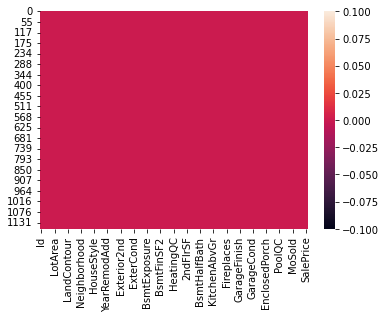

In [119]:
# cheking null values visually
sns.heatmap(df.isna())

Handled null values with less than 10% data loss

Data Visualization

In [120]:
# checking columns and dtypes
df.dtypes

Id                 int64
MSSubClass         int64
MSZoning          object
LotFrontage      float64
LotArea            int64
Street            object
Alley             object
LotShape          object
LandContour       object
Utilities         object
LotConfig         object
LandSlope         object
Neighborhood      object
Condition1        object
Condition2        object
BldgType          object
HouseStyle        object
OverallQual        int64
OverallCond        int64
YearBuilt          int64
YearRemodAdd       int64
RoofStyle         object
RoofMatl          object
Exterior1st       object
Exterior2nd       object
MasVnrType        object
MasVnrArea       float64
ExterQual         object
ExterCond         object
Foundation        object
BsmtQual          object
BsmtCond          object
BsmtExposure      object
BsmtFinType1      object
BsmtFinSF1         int64
BsmtFinType2      object
BsmtFinSF2         int64
BsmtUnfSF          int64
TotalBsmtSF        int64
Heating           object


In [208]:
df.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,127,120,RL,70.98847,4928,Pave,Grvl,IR1,Lvl,AllPub,Inside,Gtl,NPkVill,Norm,Norm,TwnhsE,1Story,6,5,1976,1976,Gable,CompShg,Plywood,Plywood,None,0.0,TA,TA,CBlock,Gd,TA,No,ALQ,120,Unf,0,958,1078,GasA,TA,Y,SBrkr,958,0,0,958,0,0,2,0,2,1,TA,5,Typ,1,TA,Attchd,1977.0,RFn,2,440,TA,TA,Y,0,205,0,0,0,0,Gd,MnPrv,Shed,0,2,2007,WD,Normal,128000
1,889,20,RL,95.00000,15865,Pave,Grvl,IR1,Lvl,AllPub,Inside,Mod,NAmes,Norm,Norm,1Fam,1Story,8,6,1970,1970,Flat,Tar&Grv,Wd Sdng,Wd Sdng,None,0.0,Gd,Gd,PConc,TA,Gd,Gd,ALQ,351,Rec,823,1043,2217,GasA,Ex,Y,SBrkr,2217,0,0,2217,1,0,2,0,4,1,Gd,8,Typ,1,TA,Attchd,1970.0,Unf,2,621,TA,TA,Y,81,207,0,0,224,0,Gd,MnPrv,Shed,0,10,2007,WD,Normal,268000
2,793,60,RL,92.00000,9920,Pave,Grvl,IR1,Lvl,AllPub,CulDSac,Gtl,NoRidge,Norm,Norm,1Fam,2Story,7,5,1996,1997,Gable,CompShg,MetalSd,MetalSd,None,0.0,Gd,TA,PConc,Gd,TA,Av,GLQ,862,Unf,0,255,1117,GasA,Ex,Y,SBrkr,1127,886,0,2013,1,0,2,1,3,1,TA,8,Typ,1,TA,Attchd,1997.0,Unf,2,455,TA,TA,Y,180,130,0,0,0,0,Gd,MnPrv,Shed,0,6,2007,WD,Normal,269790
3,110,20,RL,105.00000,11751,Pave,Grvl,IR1,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,6,1977,1977,Hip,CompShg,Plywood,Plywood,BrkFace,480.0,TA,TA,CBlock,Gd,TA,No,BLQ,705,Unf,0,1139,1844,GasA,Ex,Y,SBrkr,1844,0,0,1844,0,0,2,0,3,1,TA,7,Typ,1,TA,Attchd,1977.0,RFn,2,546,TA,TA,Y,0,122,0,0,0,0,Gd,MnPrv,Shed,0,1,2010,COD,Normal,190000
4,422,20,RL,70.98847,16635,Pave,Grvl,IR1,Lvl,AllPub,FR2,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,7,1977,2000,Gable,CompShg,CemntBd,CmentBd,Stone,126.0,Gd,TA,CBlock,Gd,TA,No,ALQ,1246,Unf,0,356,1602,GasA,Gd,Y,SBrkr,1602,0,0,1602,0,1,2,0,3,1,Gd,8,Typ,1,TA,Attchd,1977.0,Fin,2,529,TA,TA,Y,240,0,0,0,0,0,Gd,MnPrv,Shed,0,6,2009,WD,Normal,215000


<AxesSubplot:xlabel='MSSubClass', ylabel='SalePrice'>

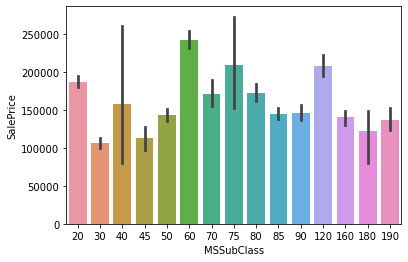

In [34]:
# checking relation between MSSubClass and Y variable
sns.barplot(x = 'MSSubClass',y = 'SalePrice',data = df)

OBS : 60 MSSubClass Have Highest House Sales Price 


<AxesSubplot:xlabel='MSZoning', ylabel='count'>

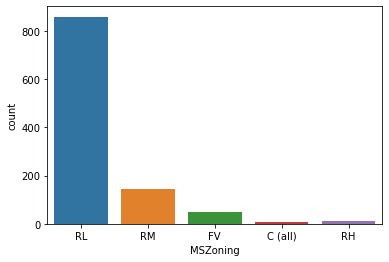

In [35]:
sns.countplot(x = 'MSZoning', data =df)

OBS : MSZoning Have highest zone RL

<AxesSubplot:xlabel='LotFrontage', ylabel='SalePrice'>

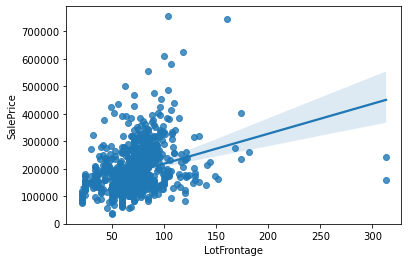

In [36]:
sns.regplot(x = 'LotFrontage', y = 'SalePrice', data =df)

OBS : LotFrontage Have Positive Relation with SalePrice

<AxesSubplot:xlabel='LotArea', ylabel='SalePrice'>

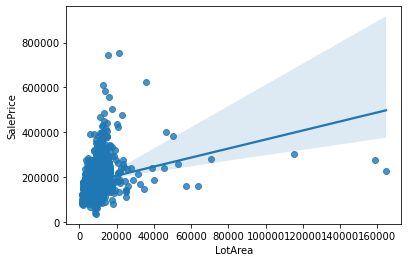

In [37]:
sns.regplot(x = 'LotArea', y = 'SalePrice', data = df)

OBS : LotArea Have Positive Relation with SalePrice

<AxesSubplot:xlabel='Street', ylabel='count'>

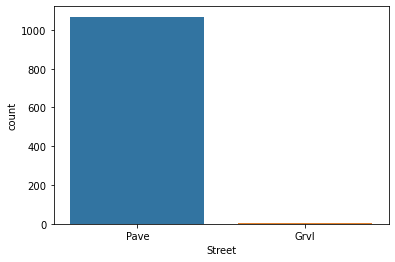

In [38]:
sns.countplot(x = 'Street', data =df)

90% Houses are in Pave (1000+)

<AxesSubplot:xlabel='Alley', ylabel='count'>

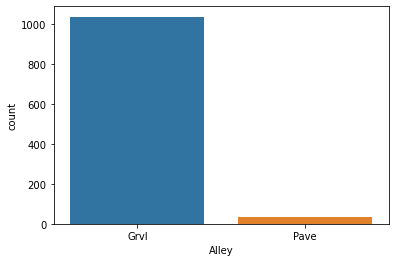

In [39]:
sns.countplot(x = 'Alley', data =df)

1000+ Houses are in Grvl

<AxesSubplot:xlabel='LotShape', ylabel='count'>

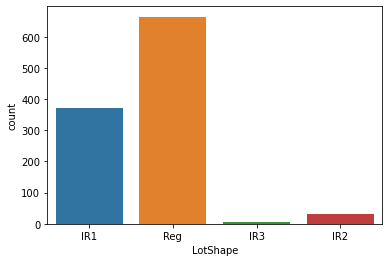

In [40]:
sns.countplot(x = 'LotShape', data =df)

Reg LotShape is highest in Houses

In [ ]:
sns.pairplot(df)

In [ ]:
df.columns

In [ ]:
df.head()

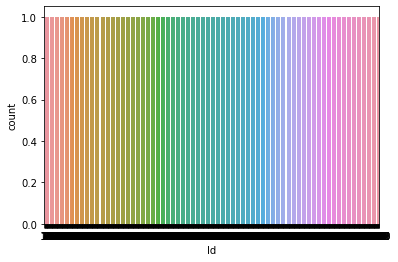

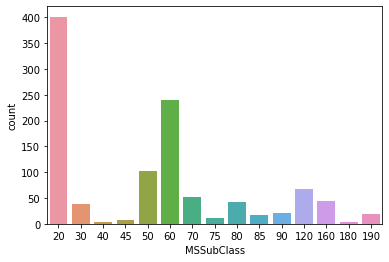

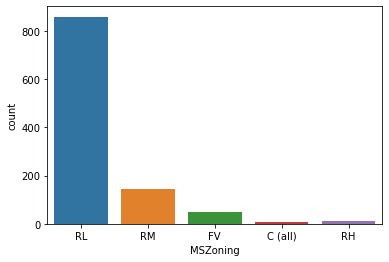

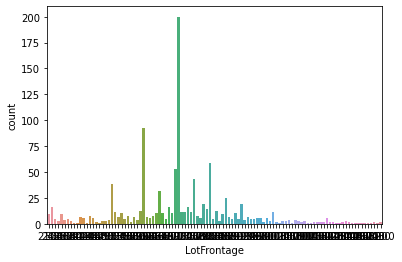

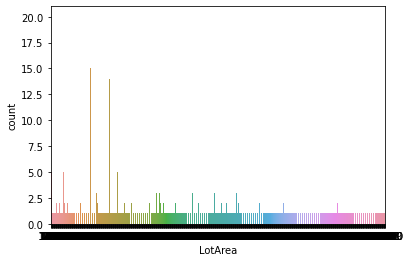

...

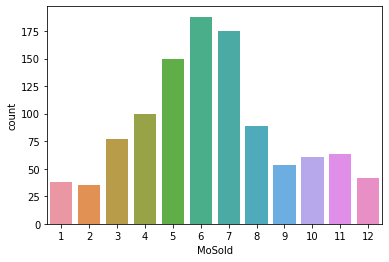

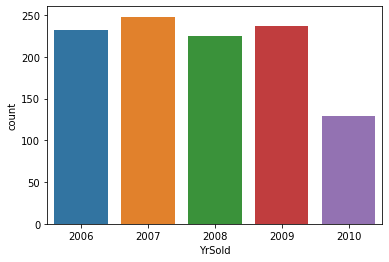

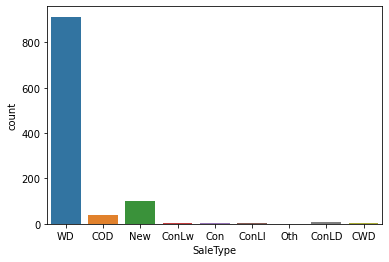

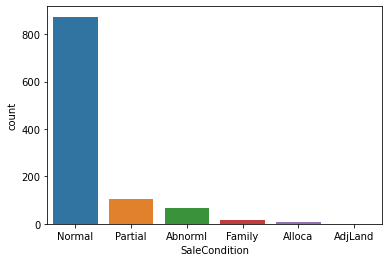

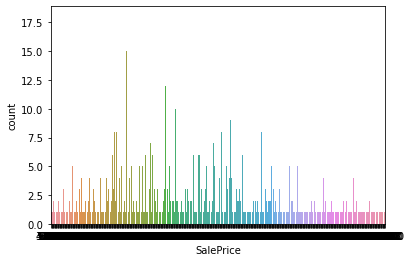

In [45]:
for i in df.columns:
    sns.countplot(df[i])
    plt.show()

In [54]:
df['SaleCondition'].value_counts()

array([874, 104,  67,  18,   7,   1], dtype=int64)

In [60]:
max_values=df.max()
max_counts = df.eq(max_values).sum()

# Find the unique maximum values
unique_max_values = max_values[max_counts == 1]

# Print the number of occurrences and the unique maximum values
print(max_counts,unique_max_values)


Id                  1
MSSubClass         19
MSZoning          146
LotFrontage         2
LotArea             1
Street           1068
Alley              34
LotShape          664
LandContour       963
Utilities        1071
LotConfig         767
LandSlope          11
Neighborhood        9
Condition1          4
Condition2          1
BldgType           88
HouseStyle         47
OverallQual        14
OverallCond        16
YearBuilt           1
YearRemodAdd        5
RoofStyle           2
RoofMatl            6
Exterior1st        15
Exterior2nd        26
MasVnrType         98
MasVnrArea          1
ExterQual         637
ExterCond         943
Foundation          1
BsmtQual          474
BsmtCond          984
BsmtExposure      706
BsmtFinType1      314
BsmtFinSF1          1
BsmtFinType2      938
BsmtFinSF2          1
BsmtUnfSF           1
TotalBsmtSF         1
Heating             1
HeatingQC         311
CentralAir       1020
Electrical        996
1stFlrSF            1
2ndFlrSF            1
LowQualFin

In [81]:
print(df['MSSubClass'].max(),df['MSSubClass'][m])

190 190


In [82]:
m=df['MSSubClass'].idxmax()
m

210

In [67]:
p

,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,0
Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice,
1,60,RL,65.00000,8450,Pave,Grvl,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,Gd,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,Gd,MnPrv,Shed,0,2,2008,WD,Normal,208500,1
962,60,RL,70.98847,12227,Pave,Grvl,IR1,Lvl,AllPub,Corner,Gtl,NWAmes,PosN,Norm,1Fam,2Story,6,7,1977,1995,Gable,CompShg,HdBoard,HdBoard,BrkFace,424.0,TA,Gd,CBlock,Gd,Gd,No,ALQ,896,Unf,0,434,1330,GasA,TA,Y,SBrkr,1542,1330,0,2872,1,0,2,1,4,1,TA,11,Typ,1,TA,Attchd,1977.0,Fin,2,619,TA,TA,Y,550,282,0,0,0,0,Gd,MnPrv,Shed,0,7,2008,WD,Normal,272000,1
941,90,RL,55.00000,12640,Pave,Grvl,IR1,Lvl,AllPub,Inside,Gtl,Mitchel,Norm,Norm,Duplex,1Story,6,5,1976,1976,Gable,CompShg,Plywood,Plywood,None,0.0,TA,TA,CBlock,TA,TA,Gd,Rec,936,LwQ,396,396,1728,GasA,TA,Y,SBrkr,1728,0,0,1728,0,0,2,0,4,2,TA,8,Typ,0,Gd,Attchd,1976.0,Unf,2,574,TA,TA,Y,40,0,0,0,0,0,Gd,MnPrv,Shed,0,7,2006,WD,Normal,150900,1
942,60,RL,70.98847,8755,Pave,Grvl,IR1,Lvl,AllPub,FR2,Gtl,Gilbert,RRNn,Norm,1Fam,2Story,7,5,1999,1999,Gable,CompShg,VinylSd,VinylSd,BrkFace,298.0,Gd,TA,PConc,Gd,TA,No,ALQ,772,Unf,0,220,992,GasA,Ex,Y,SBrkr,1022,1038,0,2060,1,0,2,1,3,1,Gd,8,Typ,1,TA,BuiltIn,1999.0,RFn,2,390,TA,TA,Y,0,0,0,168,0,0,Gd,GdPrv,Shed,0,6,2009,WD,Normal,214000,1
944,90,RL,100.00000,25000,Pave,Grvl,Reg,Low,AllPub,Inside,Gtl,Mitchel,Norm,Norm,Duplex,1Story,5,4,1967,1967,Gable,CompShg,HdBoard,Plywood,None,0.0,TA,TA,CBlock,TA,TA,Av,Unf,0,Unf,0,1632,1632,GasA,TA,Y,SBrkr,1632,0,0,1632,0,0,2,0,4,2,TA,8,Typ,0,Gd,Attchd,1967.0,Unf,2,576,TA,TA,P,0,0,0,0,0,0,Gd,MnPrv,Shed,0,6,2007,WD,Normal,143000,1
946,50,RM,98.00000,8820,Pave,Grvl,Reg,Lvl,AllPub,Corner,Gtl,OldTown,Norm,Norm,1Fam,1.5Fin,5,6,1890,1996,Hip,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,BrkTil,TA,TA,No,LwQ,1088,Unf,0,0,1088,GasA,TA,Y,SBrkr,1188,561,120,1869,0,0,1,0,2,1,TA,7,Typ,0,Gd,Detchd,1963.0,Unf,2,456,TA,TA,Y,48,0,244,0,0,0,Gd,MnWw,Shed,0,9,2009,WD,Normal,124900,1
947,80,RL,70.00000,8163,Pave,Grvl,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,SLvl,5,6,1959,1959,Gable,CompShg,HdBoard,HdBoard,BrkFace,128.0,TA,Gd,CBlock,TA,TA,Av,ALQ,748,BLQ,294,102,1144,GasA,TA,Y,SBrkr,1144,0,0,1144,1,0,1,0,3,1,TA,6,Typ,1,TA,Attchd,1959.0,RFn,1,796,TA,TA,Y,86,0,0,0,0,0,Gd,MnPrv,Shed,0,3,2006,WD,Normal,143000,1
950,20,RL,78.00000,9360,Pave,Grvl,Reg,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,7,1972,2006,Hip,CompShg,Plywood,Plywood,None,0.0,TA,TA,CBlock,TA,TA,No,ALQ,982,Unf,0,179,1161,GasA,TA,Y,SBrkr,1381,0,0,1381,1,0,1,1,3,1,Gd,5,Typ,1,TA,Attchd,1972.0,RFn,2,676,TA,TA,Y,0,0,0,0,0,0,Gd,MnPrv,Shed,0,3,2010,WD,Normal,197500,1
951,20,RL,60.00000,7200,Pave,Grvl,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,5,8,1950,2002,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,CBlock,TA,TA,No,ALQ,398,BLQ,149,317,864,GasA,Gd,Y,SBrkr,864,0,0,864,1,0,1,0,3,1,Gd,5,Typ,0,Gd,Detchd,1980.0,RFn,2,720,TA,TA,Y,194,0,0,0,0,0,Gd,MnPrv,Shed,0,7,2007,WD,Normal,129000,1


210

## Summary Stats

In [209]:
df.describe()

,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
count,1071.000000,1071.000000,1071.000000,1071.000000,1071.00000,1071.000000,1071.000000,1071.000000,1071.000000,1071.000000,1071.000000,1071.000000,1071.000000,1071.000000,1071.000000,1071.000000,1071.000000,1071.000000,1071.000000,1071.000000,1071.000000,1071.000000,1071.000000,1071.000000,1071.000000,1071.000000,1071.000000,1071.000000,1071.000000,1071.000000,1071.000000,1071.000000,1071.000000,1071.000000,1071.000000,1071.000000,1071.000000,1071.000000
mean,724.518207,55.947712,71.640237,10669.985994,6.22409,5.623716,1972.573296,1985.576097,108.462185,463.517274,49.807656,585.893557,1099.218487,1182.395892,359.957983,4.903828,1547.257703,0.437908,0.058824,1.574230,0.408030,2.881419,1.029879,6.576097,0.650794,1978.261438,1.880486,505.314659,100.897292,47.523810,22.212885,3.801120,16.414566,3.760971,49.219421,6.384687,2007.797386,187212.879552
std,416.756579,40.851487,22.627562,9253.315076,1.32912,1.095171,29.591802,20.454178,187.146687,465.074360,169.099214,446.943859,407.414729,390.551053,443.596680,43.841463,524.418997,0.516658,0.239341,0.548446,0.506676,0.769719,0.175733,1.554477,0.650950,24.990518,0.631496,187.208632,128.199854,64.939347,62.749818,29.876203,57.328305,46.875305,565.678621,2.676570,1.327295,78367.298698
min,1.000000,20.000000,21.000000,1300.000000,2.00000,2.000000,1880.000000,1950.000000,0.000000,0.000000,0.000000,0.000000,105.000000,438.000000,0.000000,0.000000,438.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,3.000000,0.000000,1900.000000,1.000000,160.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2006.000000,35311.000000
25%,360.000000,20.000000,60.000000,7800.000000,5.00000,5.000000,1955.000000,1968.000000,0.000000,0.000000,0.000000,244.500000,832.000000,900.000000,0.000000,0.000000,1174.500000,0.000000,0.000000,1.000000,0.000000,2.000000,1.000000,6.000000,0.000000,1961.000000,1.000000,384.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,2007.000000,135000.000000
50%,713.000000,50.000000,70.988470,9600.000000,6.00000,5.000000,1974.000000,1994.000000,0.000000,417.000000,0.000000,486.000000,1032.000000,1113.000000,0.000000,0.000000,1484.000000,0.000000,0.000000,2.000000,0.000000,3.000000,1.000000,6.000000,1.000000,1980.000000,2.000000,484.000000,26.000000,28.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,2008.000000,169500.000000
75%,1083.500000,70.000000,80.000000,11757.500000,7.00000,6.000000,2001.000000,2004.000000,169.500000,733.500000,0.000000,840.500000,1316.000000,1414.000000,743.000000,0.000000,1801.000000,1.000000,0.000000,2.000000,1.000000,3.000000,1.000000,7.000000,1.000000,2002.000000,2.000000,588.000000,180.000000,72.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,2009.000000,222000.000000
max,1460.000000,190.000000,313.000000,164660.000000,10.00000,9.000000,2010.000000,2010.000000,1600.000000,5644.000000,1474.000000,2336.000000,6110.000000,4692.000000,2065.000000,572.000000,5642.000000,2.000000,2.000000,3.000000,2.000000,6.000000,3.000000,12.000000,3.000000,2010.000000,4.000000,1418.000000,857.000000,547.000000,552.000000,508.000000,480.000000,738.000000,15500.000000,12.000000,2010.000000,755000.000000


In [90]:
df

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,127,120,RL,70.98847,4928,Pave,Grvl,IR1,Lvl,AllPub,Inside,Gtl,NPkVill,Norm,Norm,TwnhsE,1Story,6,5,1976,1976,Gable,CompShg,Plywood,Plywood,None,0.0,TA,TA,CBlock,Gd,TA,No,ALQ,120,Unf,0,958,1078,GasA,TA,Y,SBrkr,958,0,0,958,0,0,2,0,2,1,TA,5,Typ,1,TA,Attchd,1977.0,RFn,2,440,TA,TA,Y,0,205,0,0,0,0,Gd,MnPrv,Shed,0,2,2007,WD,Normal,128000
1,889,20,RL,95.00000,15865,Pave,Grvl,IR1,Lvl,AllPub,Inside,Mod,NAmes,Norm,Norm,1Fam,1Story,8,6,1970,1970,Flat,Tar&Grv,Wd Sdng,Wd Sdng,None,0.0,Gd,Gd,PConc,TA,Gd,Gd,ALQ,351,Rec,823,1043,2217,GasA,Ex,Y,SBrkr,2217,0,0,2217,1,0,2,0,4,1,Gd,8,Typ,1,TA,Attchd,1970.0,Unf,2,621,TA,TA,Y,81,207,0,0,224,0,Gd,MnPrv,Shed,0,10,2007,WD,Normal,268000
2,793,60,RL,92.00000,9920,Pave,Grvl,IR1,Lvl,AllPub,CulDSac,Gtl,NoRidge,Norm,Norm,1Fam,2Story,7,5,1996,1997,Gable,CompShg,MetalSd,MetalSd,None,0.0,Gd,TA,PConc,Gd,TA,Av,GLQ,862,Unf,0,255,1117,GasA,Ex,Y,SBrkr,1127,886,0,2013,1,0,2,1,3,1,TA,8,Typ,1,TA,Attchd,1997.0,Unf,2,455,TA,TA,Y,180,130,0,0,0,0,Gd,MnPrv,Shed,0,6,2007,WD,Normal,269790
3,110,20,RL,105.00000,11751,Pave,Grvl,IR1,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,6,1977,1977,Hip,CompShg,Plywood,Plywood,BrkFace,480.0,TA,TA,CBlock,Gd,TA,No,BLQ,705,Unf,0,1139,1844,GasA,Ex,Y,SBrkr,1844,0,0,1844,0,0,2,0,3,1,TA,7,Typ,1,TA,Attchd,1977.0,RFn,2,546,TA,TA,Y,0,122,0,0,0,0,Gd,MnPrv,Shed,0,1,2010,COD,Normal,190000
4,422,20,RL,70.98847,16635,Pave,Grvl,IR1,Lvl,AllPub,FR2,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,7,1977,2000,Gable,CompShg,CemntBd,CmentBd,Stone,126.0,Gd,TA,CBlock,Gd,TA,No,ALQ,1246,Unf,0,356,1602,GasA,Gd,Y,SBrkr,1602,0,0,1602,0,1,2,0,3,1,Gd,8,Typ,1,TA,Attchd,1977.0,Fin,2,529,TA,TA,Y,240,0,0,0,0,0,Gd,MnPrv,Shed,0,6,2009,WD,Normal,215000
5,1197,60,RL,58.00000,14054,Pave,Grvl,IR1,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,7,5,2006,2006,Gable,CompShg,VinylSd,VinylSd,None,0.0,Gd,TA,PConc,Gd,TA,Av,Unf,0,Unf,0,879,879,GasA,Ex,Y,SBrkr,879,984,0,1863,0,0,2,1,4,1,Gd,9,Typ,1,Gd,BuiltIn,2006.0,Fin,3,660,TA,TA,Y,100,17,0,0,0,0,Gd,MnPrv,Shed,0,11,2006,New,Partial,219210
6,561,20,RL,70.98847,11341,Pave,Grvl,IR1,Lvl,AllPub,Inside,Gtl,Sawyer,Norm,Norm,1Fam,1Story,5,6,1957,1996,Hip,CompShg,Wd Sdng,Wd Sdng,BrkFace,180.0,TA,TA,CBlock,Gd,TA,No,ALQ,1302,Unf,0,90,1392,GasA,TA,Y,SBrkr,1392,0,0,1392,1,0,1,1,3,1,TA,5,Mod,1,Gd,Detchd,1957.0,Unf,2,528,TA,TA,Y,0,0,0,0,95,0,Gd,MnPrv,Shed,0,5,2010,WD,Normal,121500
7,1041,20,RL,88.00000,13125,Pave,Grvl,Reg,Lvl,AllPub,Corner,Gtl,Sawyer,Norm,Norm,1Fam,1Story,5,4,1957,2000,Gable,CompShg,Wd Sdng,Wd Sdng,BrkCmn,67.0,TA,TA,CBlock,TA,TA,No,Rec,168,BLQ,682,284,1134,GasA,Ex,Y,SBrkr,1803,0,0,1803,1,0,2,0,3,1,TA,8,Maj1,1,TA,Attchd,1957.0,RFn,2,484,TA,TA,Y,0,0,0,0,0,0,Gd,GdPrv,Shed,0,1,2006,WD,Normal,155000
8,503,20,RL,70.00000,9170,Pave,Grvl,Reg,Lvl,AllPub,Corner,Gtl,Edwards,Feedr,Norm,1Fam,1Story,5,7,1965,1965,Hip,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,TA,TA,No,ALQ,698,GLQ,96,420,1214,GasA,Ex,Y,SBrkr,1214,0,0,1214,1,0,1,0,2,1,TA,6,Typ,0,Gd,Detchd,1965.0,Unf,2,461,Fa,Fa,Y,0,0,184,0,0,0,Gd,GdPrv,Shed,400,4,2007,WD,Normal,140000
9,576,50,RL,80.00000,8480,Pave,Grvl,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1.5Fin,5,5,1947,1950,Gable,CompShg,MetalSd,M

## Skewness

In [166]:
df.skew()

Id                0.033341
MSSubClass        1.412361
LotFrontage       2.815846
LotArea          10.480585
OverallQual       0.280429
OverallCond       0.807473
YearBuilt        -0.642356
YearRemodAdd     -0.559115
MasVnrArea        2.745030
BsmtFinSF1        1.901757
BsmtFinSF2        4.220138
BsmtUnfSF         0.916653
TotalBsmtSF       2.523233
1stFlrSF          1.550850
2ndFlrSF          0.774348
LowQualFinSF      9.857964
GrLivArea         1.523618
BsmtFullBath      0.474126
BsmtHalfBath      3.958624
FullBath          0.010016
HalfBath          0.547067
BedroomAbvGr     -0.089714
KitchenAbvGr      6.040225
TotRmsAbvGrd      0.635557
Fireplaces        0.599464
GarageYrBlt      -0.662499
GarageCars        0.188950
GarageArea        0.828589
WoodDeckSF        1.456577
OpenPorchSF       2.280681
EnclosedPorch     3.169664
3SsnPorch         9.628712
ScreenPorch       3.902441
PoolArea         12.673530
MiscVal          22.267897
MoSold            0.207167
YrSold            0.128022
S

<AxesSubplot:xlabel='MiscVal', ylabel='Density'>

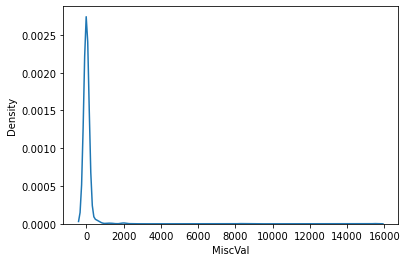

In [167]:
sns.kdeplot(df['MiscVal'])

<AxesSubplot:xlabel='LotArea', ylabel='Density'>

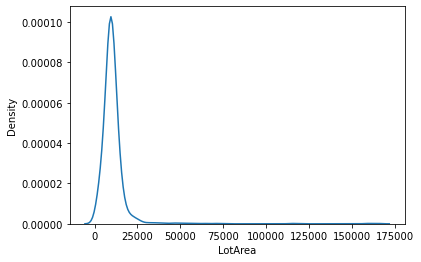

In [168]:
sns.kdeplot(df['LotArea'])

<AxesSubplot:xlabel='PoolArea', ylabel='Density'>

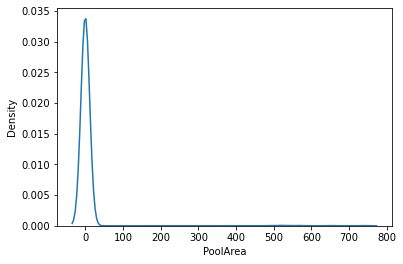

In [170]:
sns.kdeplot(df['PoolArea'])

In [28]:
from sklearn.preprocessing import LabelEncoder

In [29]:
le = LabelEncoder()

In [30]:
for col in df.columns:
    print("Value counts before label encoding for column : ",col)
    print(df[col].value_counts())
    # Perform label encoding
    le = LabelEncoder()
    df[col] = le.fit_transform(df[col])

    # Print the value counts after label encoding
    print("Value counts after label encoding for column : ",col)
    print(df[col].value_counts())

Value counts before label encoding for column :  Id
127     1
317     1
784     1
327     1
392     1
582     1
263     1
1192    1
733     1
60      1
1076    1
178     1
821     1
1179    1
448     1
1389    1
1287    1
436     1
841     1
812     1
923     1
990     1
284     1
1182    1
104     1
1345    1
925     1
218     1
282     1
489     1
619     1
548     1
1391    1
627     1
1283    1
403     1
453     1
106     1
892     1
675     1
966     1
928     1
674     1
445     1
322     1
68      1
1034    1
876     1
916     1
1195    1
891     1
1281    1
307     1
366     1
1265    1
1015    1
319     1
1054    1
478     1
1128    1
813     1
364     1
274     1
225     1
459     1
1108    1
82      1
1355    1
993     1
401     1
57      1
1300    1
161     1
460     1
1294    1
1270    1
1173    1
463     1
1103    1
663     1
1446    1
75      1
1367    1
1401    1
720     1
350     1
175     1
1207    1
1112    1
351     1
279     1
278     1
228     1
698     1
1051    

0.0       614
72.0        7
180.0       6
106.0       5
80.0        5
84.0        5
120.0       5
108.0       5
40.0        4
220.0       4
216.0       4
210.0       4
160.0       4
132.0       4
246.0       4
16.0        4
100.0       4
300.0       4
168.0       4
288.0       4
360.0       4
178.0       4
336.0       4
200.0       3
320.0       3
130.0       3
252.0       3
208.0       3
70.0        3
186.0       3
456.0       3
110.0       3
99.0        3
170.0       3
256.0       3
128.0       3
174.0       3
85.0        3
183.0       3
340.0       3
82.0        3
350.0       3
176.0       2
289.0       2
164.0       2
196.0       2
166.0       2
424.0       2
184.0       2
302.0       2
268.0       2
420.0       2
104.0       2
203.0       2
1.0         2
189.0       2
44.0        2
112.0       2
272.0       2
145.0       2
50.0        2
205.0       2
18.0        2
172.0       2
243.0       2
182.0       2
660.0       2
285.0       2
305.0       2
117.0       2
335.0       2
423.0 

Value counts after label encoding for column :  KitchenQual
3    510
2    463
0     80
1     18
Name: KitchenQual, dtype: int64
Value counts before label encoding for column :  TotRmsAbvGrd
6     303
7     254
5     196
8     137
9      59
4      59
10     38
11     13
3       7
12      5
Name: TotRmsAbvGrd, dtype: int64
Value counts after label encoding for column :  TotRmsAbvGrd
3    303
4    254
2    196
5    137
6     59
1     59
7     38
8     13
0      7
9      5
Name: TotRmsAbvGrd, dtype: int64
Value counts before label encoding for column :  Functional
Typ     999
Min2     27
Min1     24
Mod       9
Maj1      8
Maj2      3
Sev       1
Name: Functional, dtype: int64
Value counts after label encoding for column :  Functional
6    999
3     27
2     24
4      9
0      8
1      3
5      1
Name: Functional, dtype: int64
Value counts before label encoding for column :  Fireplaces
1    502
0    474
2     90
3      5
Name: Fireplaces, dtype: int64
Value counts after label encoding for 

#### Removing outliers

In [31]:
from scipy.stats import zscore

In [32]:
df

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,86,11,3,41,73,1,0,0,3,0,4,0,13,2,2,4,2,4,3,73,26,1,1,7,9,2,0,3,3,1,2,3,3,0,25,5,0,489,273,0,4,1,4,171,0,0,56,0,0,2,0,2,0,3,2,6,1,4,1,63,1,1,115,4,4,2,0,142,0,0,0,0,2,2,2,0,1,1,8,4,99
1,665,0,3,66,753,1,0,0,3,0,4,1,12,2,2,0,2,6,4,67,20,0,5,11,13,2,0,2,2,2,3,1,1,0,109,4,104,515,605,0,0,1,4,630,0,0,612,1,0,2,0,4,0,2,5,6,1,4,1,56,2,1,243,4,4,2,28,143,0,0,48,0,2,2,2,0,9,1,8,4,428
2,590,5,3,63,408,1,0,0,3,0,1,0,15,2,2,0,5,5,3,93,47,1,1,6,7,2,0,2,3,2,2,3,0,2,375,5,0,132,299,0,0,1,4,281,204,0,553,1,0,2,1,3,0,3,5,6,1,4,1,83,2,1,126,4,4,2,90,100,0,0,0,0,2,2,2,0,5,1,8,4,430
3,72,0,3,76,582,1,0,0,3,0,4,0,14,2,2,0,2,4,4,74,27,3,1,7,9,1,234,3,3,1,2,3,3,1,306,5,0,546,573,0,0,1,4,594,0,0,489,0,0,2,0,3,0,3,4,6,1,4,1,63,1,1,197,4,4,2,0,94,0,0,0,0,2,2,2,0,0,4,0,4,290
4,312,0,3,41,766,1,0,0,3,0,2,0,14,2,2,0,2,4,5,74,50,1,1,3,4,3,73,2,3,1,2,3,3,0,479,5,0,188,521,0,2,1,4,522,0,0,371,0,1,2,0,3,0,2,5,6,1,4,1,63,0,1,185,4,4,2,134,0,0,0,0,0,2,2,2,0,5,3,8,4,340
5,883,5,3,28,712,1,0,0,3,0,4,0,8,2,2,0,5,5,3,103,56,1,1,10,12,2,0,2,3,2,2,3,0,5,0,5,0,462,161,0,0,1,4,122,237,0,497,0,0,2,1,4,0,2,6,6,1,2,3,92,0,2,260,4,4,2,37,7,0,0,0,0,2,2,2,0,10,0,6,5,345
6,411,0,3,41,551,1,0,0,3,0,4,0,19,2,2,0,2,3,4,54,46,3,1,11,13,1,112,3,3,1,2,3,3,0,491,5,0,28,440,0,4,1,4,430,0,0,264,1,0,1,1,3,0,3,2,4,1,2,5,43,2,1,184,4,4,2,0,0,0,0,7,0,2,2,2,0,4,4,8,4,82
7,770,0,3,59,671,1,0,3,3,0,0,0,19,2,2,0,2,3,2,54,50,1,1,11,13,0,31,3,3,1,3,3,3,4,36,1,96,145,308,0,0,1,4,586,0,0,477,1,0,2,0,3,0,3,5,0,1,4,1,43,1,1,151,4,4,2,0,0,0,0,0,0,2,0,2,0,0,0,8,4,185
8,370,0,3,40,325,1,0,3,3,0,0,0,7,1,2,0,2,3,5,62,15,3,1,6,7,2,0,3,3,1,3,3,3,0,302,2,11,233,351,0,0,1,4,337,0,0,170,1,0,1,0,2,0,3,3,6,0,2,5,51,2,1,131,1,1,2,0,0,56,0,0,0,2,0,2,3,3,1,8,4,142
9,422,4,3,51,243,1,0,3,3,0,4,0,12,2,2,0,0,3,3,44,0,1,1,6,7,2,0,3,3,1,3,3,3,4,164,5,0,211,135,0,4,1,4,96,20,0,171,0,0,1,0,2,0,3,3,6,0,2,5,33,2,0,58,4,4,2,72,0,26,0,0,0,2,2,2,0,9,2,0,0,73


In [33]:
df.drop('Utilities',axis=1,inplace=True)

In [34]:
z= np.abs(zscore(df))

In [35]:
z

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1.452271,1.708373,0.023977,0.027732,1.350146,0.053000,0.181071,1.336626,0.312766,0.613560,0.226626,0.119497,0.062714,0.028821,2.980524,0.577555,0.168679,0.569781,0.097846,0.468392,0.493857,0.137273,0.236764,0.112742,0.400701,0.680579,0.694434,0.345705,0.568406,0.280327,0.290235,0.654679,1.485030,0.895474,0.322643,0.317582,1.039009,0.022240,0.112436,1.425166,0.223607,0.271182,0.669330,0.720606,0.107014,1.337720,0.847975,0.245887,0.776684,0.805684,1.145653,0.170102,0.827270,1.014382,0.254850,0.536707,1.719571,0.716037,0.062258,0.223283,0.189345,0.451319,0.225329,0.193228,0.246801,0.774953,2.522194,0.345451,0.125537,0.272905,0.072500,0.058075,0.262253,0.038680,0.161477,1.638939,0.601040,0.333461,0.175975,1.011685
1,0.420479,1.007366,0.023977,1.300584,1.554176,0.053000,0.181071,1.336626,0.312766,0.613560,3.291000,0.046067,0.062714,0.028821,0.384052,0.577555,1.336779,0.343745,0.114286,0.761868,1.682443,5.925367,1.097837,1.056714,0.400701,0.680579,0.727629,2.173005,0.942171,0.869982,2.727643,1.072320,1.485030,0.408248,0.721317,4.381979,1.173363,2.010652,0.112436,0.872693,0.223607,0.271182,1.907175,0.720606,0.107014,1.481355,1.088446,0.245887,0.776684,0.805684,1.453911,0.170102,0.371656,0.916429,0.254850,0.536707,1.719571,0.716037,0.348782,1.009378,0.189345,0.827603,0.225329,0.193228,0.246801,0.334289,2.545499,0.345451,0.125537,4.292497,0.072500,0.058075,0.262253,0.038680,0.161477,1.351357,0.601040,0.333461,0.175975,1.334836
2,0.177895,0.227061,0.023977,1.141186,0.080660,0.053000,0.181071,1.336626,0.312766,1.203370,0.226626,0.450626,0.062714,0.028821,0.384052,0.997729,0.584050,0.569781,0.804955,0.558773,0.493857,0.137273,0.570414,0.697469,0.400701,0.680579,0.727629,0.345705,0.942171,0.280327,0.290235,1.935820,0.385882,1.134636,0.322643,0.317582,0.805778,0.177959,0.112436,0.872693,0.223607,0.271182,0.051867,1.354398,0.107014,1.182208,1.088446,0.245887,0.776684,1.168887,0.154129,0.170102,0.827270,0.916429,0.254850,0.536707,1.719571,0.716037,0.756382,1.009378,0.189345,0.341412,0.225329,0.193228,0.246801,0.641467,1.543397,0.345451,0.125537,0.272905,0.072500,0.058075,0.262253,0.038680,0.161477,0.143791,0.601040,0.333461,0.175975,1.349100
3,1.497553,1.007366,0.023977,1.831910,0.823824,0.053000,0.181071,1.336626,0.312766,0.613560,0.226626,0.285061,0.062714,0.028821,0.384052,0.577555,0.168679,0.343745,0.133202,0.419479,1.883316,0.137273,0.236764,0.112742,1.188747,2.258989,0.694434,0.345705,0.568406,0.280327,0.290235,0.654679,0.935456,0.734414,0.322643,0.317582,1.333555,1.818998,0.112436,0.872693,0.223607,0.271182,1.705096,0.720606,0.107014,0.857710,0.847975,0.245887,0.776684,0.805684,0.154129,0.170102,0.827270,0.272825,0.254850,0.536707,1.719571,0.716037,0.062258,0.223283,0.189345,0.367990,0.225329,0.193228,0.246801,0.774953,1.403569,0.345451,0.125537,0.272905,0.072500,0.058075,0.262253,0.038680,0.161477,2.012726,1.660251,4.517287,0.175975,0.350581
4,0.721284,1.007366,0.023977,0.027732,1.609700,0.053000,0.181071,1.336626,0.312766,0.597726,0.226626,0.285061,0.062714,0.028821,0.384052,0.577555,0.168679,1.257271,0.133202,0.705511,0.493857,0.137273,1.571365,1.574561,1.990149,0.236466,0.727629,0.345705,0.568406,0.2

In [40]:
df.shape

(1071, 80)

In [41]:
newdf=df[(z<3).all(axis=1)]

In [42]:
newdf.shape

(456, 80)

Most of the columns have object dtype therefore skipped newdf 

#### Correlation Test

In [43]:
df.corr()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
Id,1.000000,0.011956,0.000766,-0.025639,-0.006734,-0.002057,-0.011110,0.022876,-0.009427,0.062175,0.007840,-0.010456,-0.005088,0.027651,0.020736,0.005124,-0.049346,0.039140,-0.024792,-0.024596,0.039209,-0.028517,-0.039490,-0.038686,0.063031,-0.064842,-0.006498,0.021184,-0.017445,0.055146,0.019632,-0.027828,0.002777,0.000702,0.037036,0.010749,-0.027783,-0.036215,0.049784,0.014002,0.004396,0.028634,-0.002556,-0.040572,-0.065318,-0.039464,0.034679,-0.051190,-0.018654,-0.047217,0.012942,0.006637,0.002893,-0.006154,0.020060,-0.023700,0.000082,0.009469,-0.003974,0.006924,0.003660,0.004209,-0.006965,0.003020,-0.011618,-0.029041,-0.030254,0.005945,-0.007346,0.001603,0.067812,-0.013681,-0.002648,0.005567,0.033314,0.017119,0.000842,0.022822,-0.008309,-0.043057
MSSubClass,0.011956,1.000000,0.005814,-0.325625,-0.287550,-0.012034,0.175226,0.051987,-0.013770,0.060190,-0.003682,-0.007096,-0.047177,-0.022807,0.692169,0.453844,0.118466,-0.091739,0.061574,0.060192,-0.110071,-0.028227,-0.066839,-0.096117,-0.035291,0.038106,-0.052779,0.015563,0.075089,-0.080335,-0.006421,-0.086548,0.031623,-0.055330,0.048751,-0.078546,-0.122722,-0.255548,0.062054,-0.023922,-0.101648,0.058169,-0.227086,0.304667,0.029910,0.143667,-0.016811,0.021142,0.157950,0.217988,-0.016720,0.280099,-0.033624,0.092497,0.008939,0.017372,0.062741,0.088851,0.080459,-0.045913,0.047944,-0.049530,-0.021295,-0.042983,-0.032101,-0.018545,0.031887,-0.000166,-0.043147,0.001869,0.022854,-0.010797,0.026452,-0.001621,-0.024007,0.005852,-0.040933,0.047425,-0.010484,-0.003600
MSZoning,0.000766,0.005814,1.000000,-0.064205,-0.036930,0.171400,-0.380436,0.050178,-0.011974,-0.037022,-0.026520,-0.255917,-0.031700,0.016656,-0.033159,-0.127949,-0.148433,0.194427,-0.323555,-0.177182,0.014877,0.010337,0.000323,0.018327,-0.035649,-0.031304,0.178614,-0.108721,-0.262640,0.131186,-0.004347,0.051931,0.030280,-0.045236,-0.028247,0.027667,-0.014271,-0.060930,0.054291,0.137478,-0.029823,-0.108939,-0.020869,-0.077245,0.068873,-0.073744,-0.017430,0.006633,-0.194606,-0.128804,0.019278,0.064175,0.116858,-0.016606,-0.091804,0.008262,0.003979,0.139812,-0.271329,0.162747,-0.135537,-0.184182,-0.179064,-0.093913,-0.110795,-0.014289,-0.164750,0.143353,0.003489,0.024672,-0.001738,0.001392,-0.045121,0.000927,0.013581,-0.016331,-0.003116,0.068876,-0.012812,-0.205447
LotFrontage,-0.025639,-0.325625,-0.064205,1.000000,0.565406,-0.037955,-0.219792,-0.144834,-0.020694,-0.184053,0.013086,0.072572,-0.028008,0.017768,-0.451981,0.080577,0.219792,-0.050517,0.115315,0.074777,0.155596,0.074694,0.067093,0.090643,-0.064665,0.212588,-0.160077,0.054071,0.098146,-0.172013,0.055884,-0.131308,-0.023516,0.141353,-0.011872,0.008183,0.090577,0.310437,-0.032988,-0.060994,0.089833,0.076155,0.348527,0.153936,-0.012579,0.312802,0.076009,0.006868,0.184074,0.048383,0.280582,0.007427,-0.163644,0.336375,0.038802,0.219304,0.089670,-0.273583,0.063541,-0.185920,0.285291,0.325478,0.055183,0.058419,0.093836,0.114130,0.163345,0.010821,0.059634,0.039471,0.071730,-0.133130,-0.057931,0.011862,-0.007771,0.018339,-0.001710,-0.030399,0.054355,0.341141
LotArea,-0.006734,-0.287550,-0.036930,0.565406,1.000000,-0.053698,-0.183536,-0.309400

<AxesSubplot:>

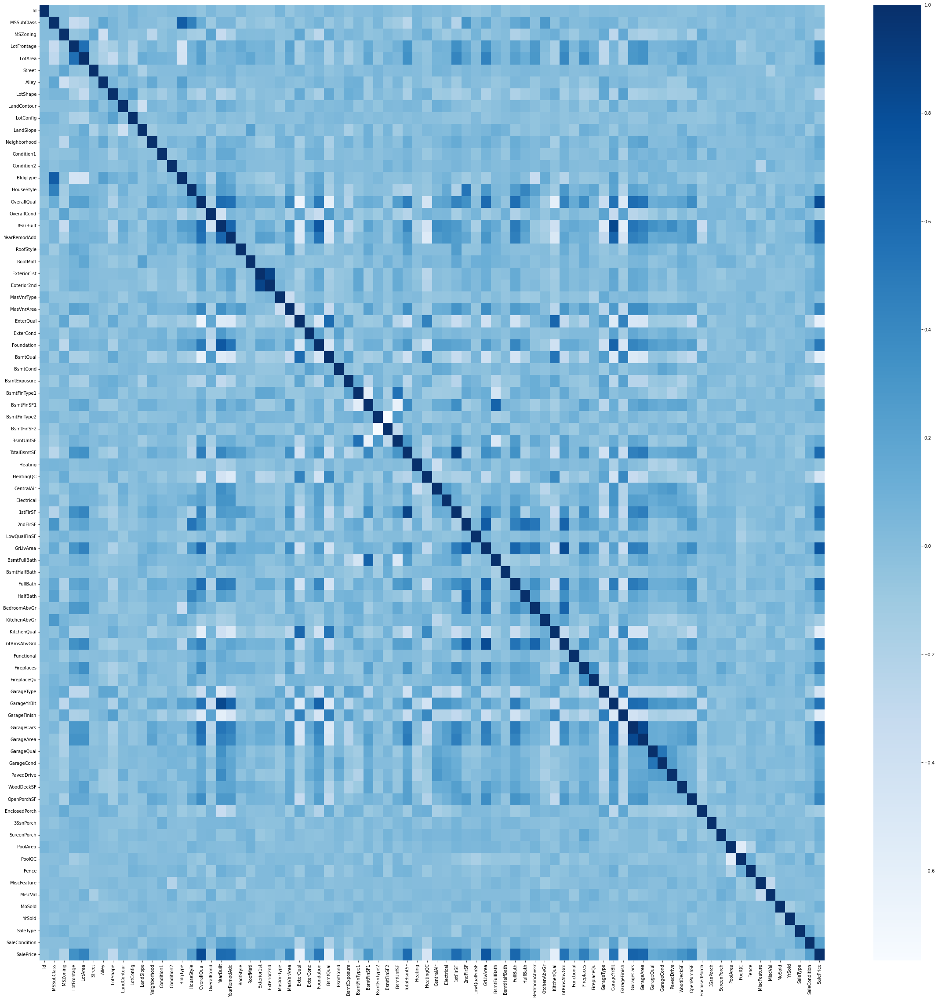

In [46]:
plt.figure(figsize=(40,40))
sns.heatmap(df.corr(),cmap='Blues',)

<AxesSubplot:xlabel='MiscFeature', ylabel='SalePrice'>

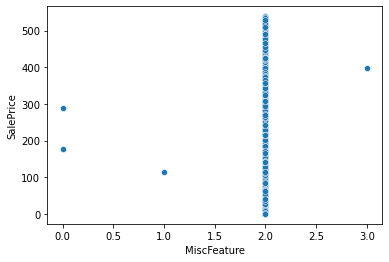

In [47]:
sns.scatterplot(df['MiscFeature'],df['SalePrice'])

#### VIF

In [48]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

In [49]:
x=df.iloc[:,:-1]

In [50]:
x.shape

(1071, 79)

In [51]:
x.shape[1]

79

In [52]:
y=df.iloc[:,-1]

In [53]:
y.shape

(1071,)

In [54]:
df

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,86,11,3,41,73,1,0,0,3,4,0,13,2,2,4,2,4,3,73,26,1,1,7,9,2,0,3,3,1,2,3,3,0,25,5,0,489,273,0,4,1,4,171,0,0,56,0,0,2,0,2,0,3,2,6,1,4,1,63,1,1,115,4,4,2,0,142,0,0,0,0,2,2,2,0,1,1,8,4,99
1,665,0,3,66,753,1,0,0,3,4,1,12,2,2,0,2,6,4,67,20,0,5,11,13,2,0,2,2,2,3,1,1,0,109,4,104,515,605,0,0,1,4,630,0,0,612,1,0,2,0,4,0,2,5,6,1,4,1,56,2,1,243,4,4,2,28,143,0,0,48,0,2,2,2,0,9,1,8,4,428
2,590,5,3,63,408,1,0,0,3,1,0,15,2,2,0,5,5,3,93,47,1,1,6,7,2,0,2,3,2,2,3,0,2,375,5,0,132,299,0,0,1,4,281,204,0,553,1,0,2,1,3,0,3,5,6,1,4,1,83,2,1,126,4,4,2,90,100,0,0,0,0,2,2,2,0,5,1,8,4,430
3,72,0,3,76,582,1,0,0,3,4,0,14,2,2,0,2,4,4,74,27,3,1,7,9,1,234,3,3,1,2,3,3,1,306,5,0,546,573,0,0,1,4,594,0,0,489,0,0,2,0,3,0,3,4,6,1,4,1,63,1,1,197,4,4,2,0,94,0,0,0,0,2,2,2,0,0,4,0,4,290
4,312,0,3,41,766,1,0,0,3,2,0,14,2,2,0,2,4,5,74,50,1,1,3,4,3,73,2,3,1,2,3,3,0,479,5,0,188,521,0,2,1,4,522,0,0,371,0,1,2,0,3,0,2,5,6,1,4,1,63,0,1,185,4,4,2,134,0,0,0,0,0,2,2,2,0,5,3,8,4,340
5,883,5,3,28,712,1,0,0,3,4,0,8,2,2,0,5,5,3,103,56,1,1,10,12,2,0,2,3,2,2,3,0,5,0,5,0,462,161,0,0,1,4,122,237,0,497,0,0,2,1,4,0,2,6,6,1,2,3,92,0,2,260,4,4,2,37,7,0,0,0,0,2,2,2,0,10,0,6,5,345
6,411,0,3,41,551,1,0,0,3,4,0,19,2,2,0,2,3,4,54,46,3,1,11,13,1,112,3,3,1,2,3,3,0,491,5,0,28,440,0,4,1,4,430,0,0,264,1,0,1,1,3,0,3,2,4,1,2,5,43,2,1,184,4,4,2,0,0,0,0,7,0,2,2,2,0,4,4,8,4,82
7,770,0,3,59,671,1,0,3,3,0,0,19,2,2,0,2,3,2,54,50,1,1,11,13,0,31,3,3,1,3,3,3,4,36,1,96,145,308,0,0,1,4,586,0,0,477,1,0,2,0,3,0,3,5,0,1,4,1,43,1,1,151,4,4,2,0,0,0,0,0,0,2,0,2,0,0,0,8,4,185
8,370,0,3,40,325,1,0,3,3,0,0,7,1,2,0,2,3,5,62,15,3,1,6,7,2,0,3,3,1,3,3,3,0,302,2,11,233,351,0,0,1,4,337,0,0,170,1,0,1,0,2,0,3,3,6,0,2,5,51,2,1,131,1,1,2,0,0,56,0,0,0,2,0,2,3,3,1,8,4,142
9,422,4,3,51,243,1,0,3,3,4,0,12,2,2,0,0,3,3,44,0,1,1,6,7,2,0,3,3,1,3,3,3,4,164,5,0,211,135,0,4,1,4,96,20,0,171,0,0,1,0,2,0,3,3,6,0,2,5,33,2,0,58,4,4,2,72,0,26,0,0,0,2,2,2,0,9,2,0,0,73


In [55]:
def vif_cal():
    vif=pd.DataFrame()
    vif['vif']=[variance_inflation_factor(x.values,i) for i in range(x.shape[1])]
    vif['columns']=x.columns
    print(vif)

In [56]:
vif_cal()

           vif        columns
0     4.322291             Id
1    10.940125     MSSubClass
2    41.348388       MSZoning
3    11.948111    LotFrontage
4     8.777050        LotArea
5   384.166198         Street
6     1.577032          Alley
7     3.663681       LotShape
8    23.063204    LandContour
9     5.016440      LotConfig
10    1.560178      LandSlope
11    6.684153   Neighborhood
12    7.422786     Condition1
13   67.367856     Condition2
14    5.638495       BldgType
15   10.359316     HouseStyle
16   44.507722    OverallQual
17   25.070857    OverallCond
18   73.577278      YearBuilt
19   13.154939   YearRemodAdd
20    5.050133      RoofStyle
21    4.620188       RoofMatl
22   33.929251    Exterior1st
23   38.104808    Exterior2nd
24   12.205192     MasVnrType
25    2.727075     MasVnrArea
26   38.108624      ExterQual
27   64.668900      ExterCond
28   13.590177     Foundation
29   18.168909       BsmtQual
30   22.462731       BsmtCond
31    7.465343   BsmtExposure
32    6.29

In [100]:
df.columns

Index(['Id', 'MSSubClass', 'MSZoning', 'LotFrontage', 'LotArea', 'Street',
       'Alley', 'LotShape', 'LandContour', 'LotConfig', 'LandSlope',
       'Neighborhood', 'Condition1', 'Condition2', 'BldgType', 'HouseStyle',
       'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd', 'RoofStyle',
       'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType', 'MasVnrArea',
       'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual', 'BsmtCond',
       'BsmtExposure', 'BsmtFinType1', 'BsmtFinSF1', 'BsmtFinType2',
       'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', 'Heating', 'HeatingQC',
       'CentralAir', 'Electrical', '1stFlrSF', '2ndFlrSF', 'LowQualFinSF',
       'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenAbvGr', 'KitchenQual', 'TotRmsAbvGrd',
       'Functional', 'Fireplaces', 'FireplaceQu', 'GarageType', 'GarageYrBlt',
       'GarageFinish', 'GarageCars', 'GarageArea', 'GarageQual', 'GarageCond',
       'PavedDrive', 'WoodDeckS

y=df.iloc[:,-1]

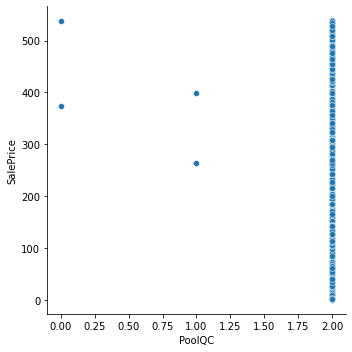

In [57]:
sns.relplot(df['PoolQC'],df['SalePrice'])

#### Making Normal Distribution

In [38]:
x= df.iloc[:,:-1]

In [39]:
y=df.iloc[:,-1]

#preprocessing = labelencoder & standard scalar

from sklearn.preprocessing import StandardScaler

ss = StandardScaler()

x=ss.fit_transform(x)

x

In [40]:
from sklearn.model_selection import train_test_split

In [44]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.20,random_state=52)

In [45]:
x_test.shape

(215, 79)

In [46]:
y_test.shape

(215,)

##### Linear Reg

In [47]:
from sklearn.linear_model import LinearRegression

In [48]:
lr=LinearRegression()

In [49]:
lr.fit(x_train,y_train)

LinearRegression()

In [50]:
lr.score(x_train,y_train)

0.9097731375520329

In [51]:
lr.intercept_

-126.94796923575603

In [52]:
# coef means if x increase by 1 then how many y will increase
lr.coef_

array([-2.41875210e-03, -1.72865235e-01, -1.34776975e+01, -1.48009312e-01,
        3.83634015e-02,  7.99853573e+01,  2.97555744e+00, -7.45629291e-01,
        5.72872189e-01,  9.69002033e-01,  1.32608749e+01, -8.69132283e-02,
       -2.16100159e+00, -1.30846482e+01, -3.61164669e+00, -2.41312191e-01,
        1.94594561e+01,  1.37313745e+01,  8.91880594e-01,  3.34357246e-01,
       -2.51654147e+00,  4.83355703e+00, -2.70688702e+00,  2.52412830e+00,
        9.31114441e-01, -2.96779225e-02,  7.09761297e-01, -1.81036083e+00,
        2.83176172e+00, -3.16942197e+00,  4.27260131e+00, -8.11547200e-01,
       -1.49923907e+00, -7.97737879e-02, -1.46387959e+00, -4.26185157e-01,
       -1.01801224e-01,  1.97066557e-01, -1.77856441e+01, -3.30254705e+00,
        2.58288069e+00, -2.07494695e+00,  2.98096995e-02,  9.12617177e-02,
       -1.94516507e+00,  2.52691181e-01,  9.77206313e+00, -4.42028417e-01,
        7.52928812e+00, -1.18272106e+00, -1.09809970e+01, -7.12349640e+01,
       -5.92148331e+00, -

In [53]:
col=df.columns

In [54]:
list(zip(lr.coef_,col))

[(-0.0024187520981876617, 'Id'),
 (-0.17286523513145347, 'MSSubClass'),
 (-13.477697529995146, 'MSZoning'),
 (-0.1480093115268942, 'LotFrontage'),
 (0.03836340149367401, 'LotArea'),
 (79.985357305818, 'Street'),
 (2.9755574435941132, 'Alley'),
 (-0.7456292908118182, 'LotShape'),
 (0.5728721888088769, 'LandContour'),
 (0.9690020325521456, 'LotConfig'),
 (13.260874855976724, 'LandSlope'),
 (-0.08691322827732106, 'Neighborhood'),
 (-2.161001591388311, 'Condition1'),
 (-13.08464821638526, 'Condition2'),
 (-3.6116466883627307, 'BldgType'),
 (-0.24131219055505815, 'HouseStyle'),
 (19.459456082023642, 'OverallQual'),
 (13.731374502652608, 'OverallCond'),
 (0.891880593560666, 'YearBuilt'),
 (0.3343572456567294, 'YearRemodAdd'),
 (-2.516541465523856, 'RoofStyle'),
 (4.833557031067956, 'RoofMatl'),
 (-2.7068870169077295, 'Exterior1st'),
 (2.524128304302663, 'Exterior2nd'),
 (0.9311144412248071, 'MasVnrType'),
 (-0.029677922540479074, 'MasVnrArea'),
 (0.7097612972377184, 'ExterQual'),
 (-1.810360

In [55]:
pred= lr.predict(x_test)

In [56]:
pred

array([383.33527436,  76.92593639, 354.15896428, 177.20907367,
       271.4486297 , 390.9914915 , 218.27230888, 240.21256692,
       437.41265368, 254.27625834, 414.84086433, 200.84843872,
       133.86673077, 194.20199302,  34.89996604, 297.27981951,
       205.02784653,  67.53019428, 282.87534559, 477.63351266,
       203.97754753, 351.44778546, 340.13803844, 291.02368655,
        87.62631593, 308.6357666 , 175.52933785, 208.83818184,
       342.70343168, 258.14724133, 409.48652248,  37.90499804,
       335.528969  , 139.76782001, 137.23159713, 455.55159832,
       425.87397083, 242.76214572, 146.94921445, 544.71540032,
       341.81863083, 491.20599903, 414.31731664, 232.34239868,
       217.10634143, 392.43360715, 239.24407207, 360.6858921 ,
       372.95645129, 121.78646251, 371.7389006 , 184.828394  ,
       278.58726392, 476.19598019, 122.76649956, 148.6394545 ,
       195.16408995,  89.01209233, 402.49792339, 271.93762574,
       478.59489451, 228.04359146,  -9.68083351, 400.88

In [57]:
predicted_df=pd.DataFrame(pred)

In [58]:
predicted_df.head()

,0
0,383.335274
1,76.925936
2,354.158964
3,177.209074
4,271.448630


In [59]:
lr.score(x_test,y_test)

0.8896507006192805

#### Errors / Metrics

In [60]:
from sklearn.metrics import mean_squared_error,mean_absolute_error,r2_score

In [61]:
print('mean squared error=',mean_squared_error(y_test,pred))
print('root mean squared error=',np.sqrt(mean_squared_error(y_test,pred)))
print('mean abs error=',mean_absolute_error(y_test,pred))
print('r2 score/performence=',r2_score(y_test,pred))

mean squared error= 2365.467968394041
root mean squared error= 48.63607681951784
mean abs error= 33.9549104459018
r2 score/performence= 0.8896507006192805


In [143]:
def price_pred(values):
    values=np.array(values)
    values=values.reshape(1,-1)
    result=lr.predict(values)
    print('predicted Price is',result)

In [144]:
df.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,86,11,3,41,73,1,0,0,3,0,4,0,13,2,2,4,2,4,3,73,26,1,1,7,9,2,0,3,3,1,2,3,3,0,25,5,0,489,273,0,4,1,4,171,0,0,56,0,0,2,0,2,0,3,2,6,1,4,1,63,1,1,115,4,4,2,0,142,0,0,0,0,2,2,2,0,1,1,8,4,99
1,665,0,3,66,753,1,0,0,3,0,4,1,12,2,2,0,2,6,4,67,20,0,5,11,13,2,0,2,2,2,3,1,1,0,109,4,104,515,605,0,0,1,4,630,0,0,612,1,0,2,0,4,0,2,5,6,1,4,1,56,2,1,243,4,4,2,28,143,0,0,48,0,2,2,2,0,9,1,8,4,428
2,590,5,3,63,408,1,0,0,3,0,1,0,15,2,2,0,5,5,3,93,47,1,1,6,7,2,0,2,3,2,2,3,0,2,375,5,0,132,299,0,0,1,4,281,204,0,553,1,0,2,1,3,0,3,5,6,1,4,1,83,2,1,126,4,4,2,90,100,0,0,0,0,2,2,2,0,5,1,8,4,430
3,72,0,3,76,582,1,0,0,3,0,4,0,14,2,2,0,2,4,4,74,27,3,1,7,9,1,234,3,3,1,2,3,3,1,306,5,0,546,573,0,0,1,4,594,0,0,489,0,0,2,0,3,0,3,4,6,1,4,1,63,1,1,197,4,4,2,0,94,0,0,0,0,2,2,2,0,0,4,0,4,290
4,312,0,3,41,766,1,0,0,3,0,2,0,14,2,2,0,2,4,5,74,50,1,1,3,4,3,73,2,3,1,2,3,3,0,479,5,0,188,521,0,2,1,4,522,0,0,371,0,1,2,0,3,0,2,5,6,1,4,1,63,0,1,185,4,4,2,134,0,0,0,0,0,2,2,2,0,5,3,8,4,340


In [63]:
file2 = pd.read_csv('test.csv')

In [66]:
pred_df = pd.DataFrame(file2)

In [67]:
for col in pred_df.columns:
    print("Value counts before label encoding for column : ",col)
    print(pred_df[col].value_counts())
    # Perform label encoding
    le = LabelEncoder()
    pred_df[col] = le.fit_transform(pred_df[col])

    # Print the value counts after label encoding
    print("Value counts after label encoding for column : ",col)
    print(pred_df[col].value_counts())

Value counts before label encoding for column :  Id
337     1
960     1
1351    1
761     1
1000    1
1194    1
621     1
346     1
529     1
531     1
1204    1
1030    1
215     1
858     1
128     1
219     1
481     1
1442    1
233     1
360     1
1198    1
442     1
722     1
1350    1
1258    1
743     1
492     1
242     1
886     1
1089    1
1417    1
328     1
1375    1
572     1
11      1
441     1
867     1
1018    1
1435    1
753     1
296     1
1445    1
624     1
312     1
1174    1
1278    1
223     1
1124    1
901     1
803     1
893     1
88      1
249     1
260     1
1320    1
432     1
1362    1
866     1
58      1
6       1
1400    1
798     1
1193    1
162     1
766     1
1069    1
807     1
500     1
881     1
454     1
50      1
1255    1
90      1
1007    1
1241    1
144     1
995     1
45      1
372     1
938     1
1218    1
125     1
107     1
181     1
816     1
165     1
495     1
365     1
1431    1
1221    1
633     1
314     1
948     1
217     1
358     

Name: ExterCond, dtype: int64
Value counts after label encoding for column :  ExterCond
3    260
2     29
1      2
0      1
Name: ExterCond, dtype: int64
Value counts before label encoding for column :  Foundation
PConc     134
CBlock    118
BrkTil     34
Slab        3
Wood        2
Stone       1
Name: Foundation, dtype: int64
Value counts after label encoding for column :  Foundation
2    134
1    118
0     34
3      3
5      2
4      1
Name: Foundation, dtype: int64
Value counts before label encoding for column :  BsmtQual
TA    132
Gd    120
Ex     27
Fa      6
Name: BsmtQual, dtype: int64
Value counts after label encoding for column :  BsmtQual
3    132
2    120
0     27
4      7
1      6
Name: BsmtQual, dtype: int64
Value counts before label encoding for column :  BsmtCond
TA    270
Gd      9
Fa      6
Name: BsmtCond, dtype: int64
Value counts after label encoding for column :  BsmtCond
2    270
1      9
3      7
0      6
Name: BsmtCond, dtype: int64
Value counts before label enco

0      17
76     12
12      9
108     8
7       7
91      7
59      5
52      5
4       5
18      5
75      4
47      4
40      4
20      4
16      4
93      3
72      3
22      3
48      3
128     3
83      3
25      3
17      3
74      2
62      2
14      2
35      2
119     2
21      2
34      2
53      2
31      2
103     2
94      2
104     2
107     2
55      2
112     2
129     2
63      2
102     2
11      2
90      2
67      2
84      2
89      2
71      2
152     2
46      1
26      1
96      1
5       1
81      1
39      1
19      1
50      1
160     1
162     1
132     1
106     1
121     1
114     1
41      1
51      1
33      1
54      1
109     1
153     1
57      1
111     1
138     1
158     1
10      1
88      1
143     1
141     1
150     1
38      1
159     1
149     1
65      1
146     1
86      1
145     1
131     1
133     1
99      1
58      1
113     1
105     1
97      1
154     1
115     1
70      1
130     1
43      1
120     1
164     1
6       1
42      1


In [84]:
testdata=lr.predict(pred_df.iloc[:,:-1])

In [85]:
testdata = pd.DataFrame(testdata)

In [86]:
testdata

,0
0,-2620.545951
1,-2118.199680
2,-2254.471145
3,605.557996
4,-100.169612
5,-607.593371
6,-216.624748
7,-2605.457237
8,-2030.442295
9,-2328.044464


In [90]:
testdata.columns=['pred_price']

In [91]:
testdata=testdata.abs()

In [92]:
testdata

,pred_price
0,2620.545951
1,2118.199680
2,2254.471145
3,605.557996
4,100.169612
5,607.593371
6,216.624748
7,2605.457237
8,2030.442295
9,2328.044464


In [93]:
file2 = pd.read_csv('test.csv')

pred_df = pd.DataFrame(file2)


In [98]:
df2= pred_df.join(testdata)

In [99]:
df2.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,pred_price
0,337,20,RL,86.0,14157,Pave,NaN,IR1,HLS,AllPub,Corner,Gtl,StoneBr,Norm,Norm,1Fam,1Story,9,5,2005,2006,Hip,CompShg,VinylSd,VinylSd,Stone,200.0,Gd,TA,PConc,Ex,TA,Gd,GLQ,1249,Unf,0,673,1922,GasA,Ex,Y,SBrkr,1922,0,0,1922,1,0,2,0,3,1,Gd,8,Typ,1,Gd,Attchd,2005.0,Fin,3,676,TA,TA,Y,178,51,0,0,0,0,NaN,NaN,NaN,0,7,2007,WD,Normal,2620.545951
1,1018,120,RL,NaN,5814,Pave,NaN,IR1,Lvl,AllPub,CulDSac,Gtl,StoneBr,Norm,Norm,TwnhsE,1Story,8,5,1984,1984,Gable,CompShg,HdBoard,HdBoard,None,0.0,Gd,TA,CBlock,Gd,TA,Av,GLQ,1036,Unf,0,184,1220,GasA,Gd,Y,SBrkr,1360,0,0,1360,1,0,1,0,1,1,Gd,4,Typ,1,Ex,Attchd,1984.0,RFn,2,565,TA,TA,Y,63,0,0,0,0,0,NaN,NaN,NaN,0,8,2009,COD,Abnorml,2118.199680
2,929,20,RL,NaN,11838,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,1Story,8,5,2001,2001,Hip,CompShg,VinylSd,VinylSd,None,0.0,Gd,TA,PConc,Gd,TA,Av,Unf,0,Unf,0,1753,1753,GasA,Ex,Y,SBrkr,1788,0,0,1788,0,0,2,0,3,1,Ex,7,Typ,1,TA,Attchd,2001.0,RFn,2,522,TA,TA,Y,202,151,0,0,0,0,NaN,NaN,NaN,0,6,2009,WD,Normal,2254.471145
3,1148,70,RL,75.0,12000,Pave,NaN,Reg,Bnk,AllPub,Inside,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,7,1941,1950,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,TA,TA,No,Rec,275,Unf,0,429,704,GasA,Ex,Y,SBrkr,860,704,0,1564,0,0,1,1,3,1,Fa,7,Typ,1,Gd,Attchd,1941.0,Unf,1,234,TA,TA,Y,0,0,0,0,0,0,NaN,NaN,NaN,0,7,2009,WD,Normal,605.557996
4,1227,60,RL,86.0,14598,Pave,NaN,IR1,Lvl,AllPub,CulDSac,Gtl,Somerst,Feedr,Norm,1Fam,2Story,6,5,2007,2007,Gable,CompShg,VinylSd,VinylSd,Stone,74.0,Gd,TA,PConc,Gd,TA,Mn,Unf,0,Unf,0,894,894,GasA,Ex,Y,SBrkr,894,1039,0,1933,0,0,2,1,4,1,Gd,9,Typ,1,Gd,BuiltIn,2007.0,Fin,3,668,TA,TA,Y,100,18,0,0,0,0,NaN,NaN,NaN,0,1,2008,WD,Normal,100.169612


#### Regularization

In [152]:
# to improve accuracy of model

In [153]:
from sklearn.linear_model import Lasso,Ridge,ElasticNet

In [154]:
lasso= Lasso(alpha=0.0001)

In [155]:
lasso.fit(x_train,y_train)

Lasso(alpha=0.0001)

In [156]:
lasso.score(x_train,y_train)

0.9183762997632993

In [157]:
lasso_pred=lasso.predict(x_test)

In [158]:
r2_score(y_test,lasso_pred)

0.8642197260405505

In [159]:
ridge=Ridge(alpha=0.1)

In [160]:
ridge.fit(x_train,y_train)

Ridge(alpha=0.1)

In [161]:
ridge.score(x_train,y_train)

0.9183761845293011

In [162]:
ridge_pred=ridge.predict(x_test)

In [163]:
r2_score(y_test,ridge_pred)

0.864250475162829

#### Using More algos

In [164]:
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import SVR

In [165]:
knn= KNeighborsRegressor()
dtc= DecisionTreeRegressor()
svr = SVR()

In [166]:
models = [knn,dtc,svr]

In [167]:
for i in models:
    i.fit(x_train,y_train)
    regressor_pred=i.predict(x_test)
    print('score of',i,i.score(x_train,y_train))
    print('mean squared error of',i,mean_squared_error(y_test,regressor_pred))
    print('root mean squared error of',i,np.sqrt(mean_squared_error(y_test,regressor_pred)))
    print('mean abs errorof',i,mean_absolute_error(y_test,regressor_pred))
    print('r2 score/performence of',i,r2_score(y_test,regressor_pred))
    print('\n')

score of KNeighborsRegressor() 0.8682335022810702
mean squared error of KNeighborsRegressor() 4320.639875776397
root mean squared error of KNeighborsRegressor() 65.73157442033772
mean abs errorof KNeighborsRegressor() 47.2639751552795
r2 score/performence of KNeighborsRegressor() 0.7734753593606164


score of DecisionTreeRegressor() 1.0
mean squared error of DecisionTreeRegressor() 4871.217391304348
root mean squared error of DecisionTreeRegressor() 69.79410713881472
mean abs errorof DecisionTreeRegressor() 50.838509316770185
r2 score/performence of DecisionTreeRegressor() 0.7446094095395421


score of SVR() 0.2902052512295834
mean squared error of SVR() 13928.800200439746
root mean squared error of SVR() 118.0203380796706
mean abs errorof SVR() 96.66737183237402
r2 score/performence of SVR() 0.26973398601626997




#### Ensemble methods 

In [168]:
from sklearn.ensemble import RandomForestRegressor,GradientBoostingRegressor,AdaBoostRegressor,VotingRegressor

In [169]:
RF=RandomForestRegressor(random_state=42)
GB=GradientBoostingRegressor()
ADA=AdaBoostRegressor()

In [170]:
ens_algo=[RF,GB,ADA]

for i in ens_algo:
    i.fit(x_train,y_train)
    ens_algo_pred=i.predict(x_test)
    print('score of',i,i.score(x_train,y_train))
    print('mean squared error of',i,mean_squared_error(y_test,regressor_pred))
    print('root mean squared error of',i,np.sqrt(mean_squared_error(y_test,regressor_pred)))
    print('mean abs errorof',i,mean_absolute_error(y_test,regressor_pred))
    print('r2 score/performence of',i,r2_score(y_test,regressor_pred))
    print('\n')

score of RandomForestRegressor(random_state=42) 0.9819011565484292
mean squared error of RandomForestRegressor(random_state=42) 13928.800200439746
root mean squared error of RandomForestRegressor(random_state=42) 118.0203380796706
mean abs errorof RandomForestRegressor(random_state=42) 96.66737183237402
r2 score/performence of RandomForestRegressor(random_state=42) 0.26973398601626997


score of GradientBoostingRegressor() 0.9704906685237026
mean squared error of GradientBoostingRegressor() 13928.800200439746
root mean squared error of GradientBoostingRegressor() 118.0203380796706
mean abs errorof GradientBoostingRegressor() 96.66737183237402
r2 score/performence of GradientBoostingRegressor() 0.26973398601626997


score of AdaBoostRegressor() 0.8923665246411228
mean squared error of AdaBoostRegressor() 13928.800200439746
root mean squared error of AdaBoostRegressor() 118.0203380796706
mean abs errorof AdaBoostRegressor() 96.66737183237402
r2 score/performence of AdaBoostRegressor() 0.

#### Exporting Decision Tree Model

In [171]:
import joblib

In [172]:
dtc_obj= joblib.dump(lasso,'housesaleprice-lasso.obj')